In [17]:
from matplotlib.colors import LinearSegmentedColormap
import numpy as np
import rasters as rt

Loading surface temeprature observation from ECOSTRESS in Celsius, `Ta_C`

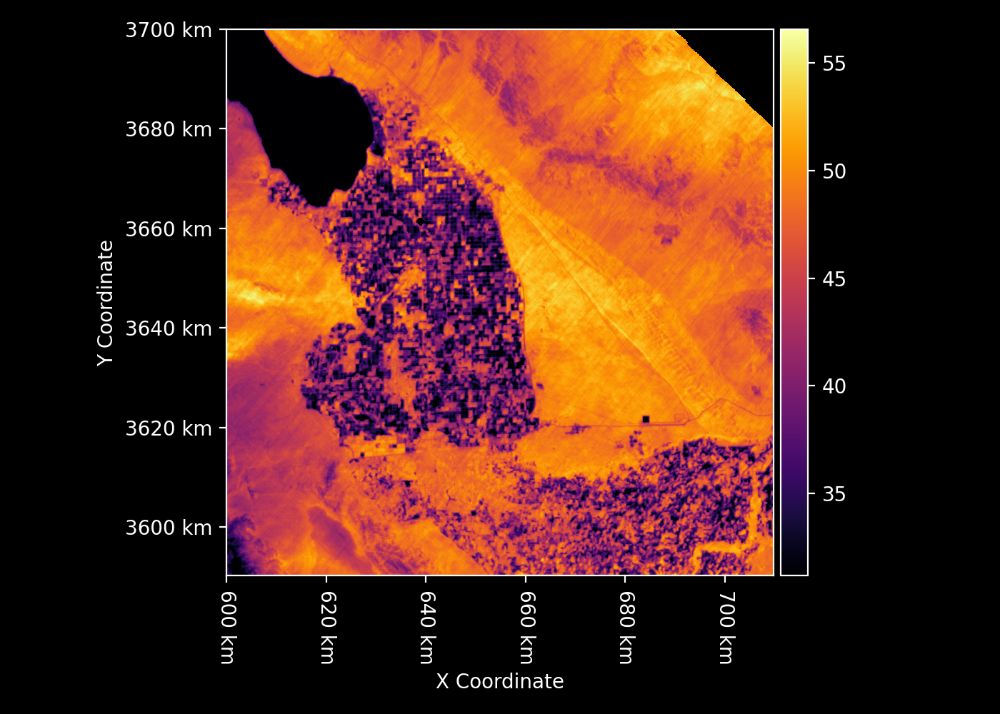

In [80]:
ST_filename = "ECOSTRESS_example_rasters/ECOv002_L2T_LSTE_21485_013_11SPS_20220420T211350_0601_01_LST.tif"
ST_cmap = "inferno"
ST_C = rt.Raster.open(ST_filename, cmap=ST_cmap) - 273.15
ST_C

Load net radiation from ECOSTRESS in watts per square meter, an estimate of the total available energy at the surface, `Rn_Wm2`

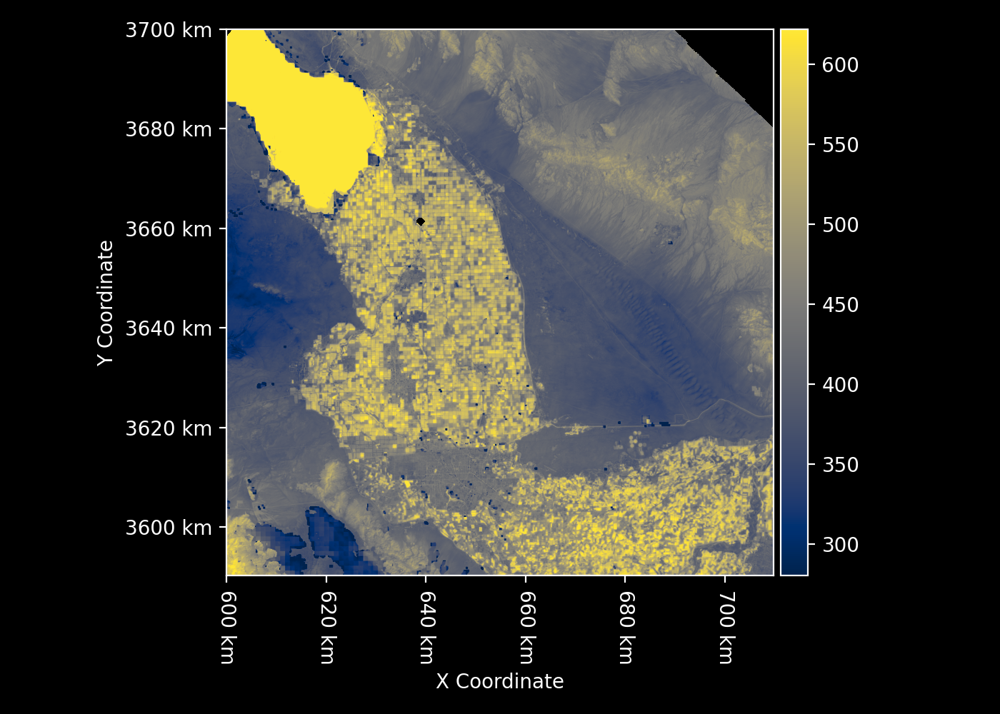

In [28]:
Rn_filename = "ECOSTRESS_example_rasters/ECOv002_L3T_SEB_21485_013_11SPS_20220420T211350_0700_01_Rn.tif"
Rn_Wm2 = rt.Raster.open(Rn_filename, cmap="cividis")
Rn_Wm2

Loading soil moisture prior from ECOSTRESS in cubic meters per cubic meters, `SM`

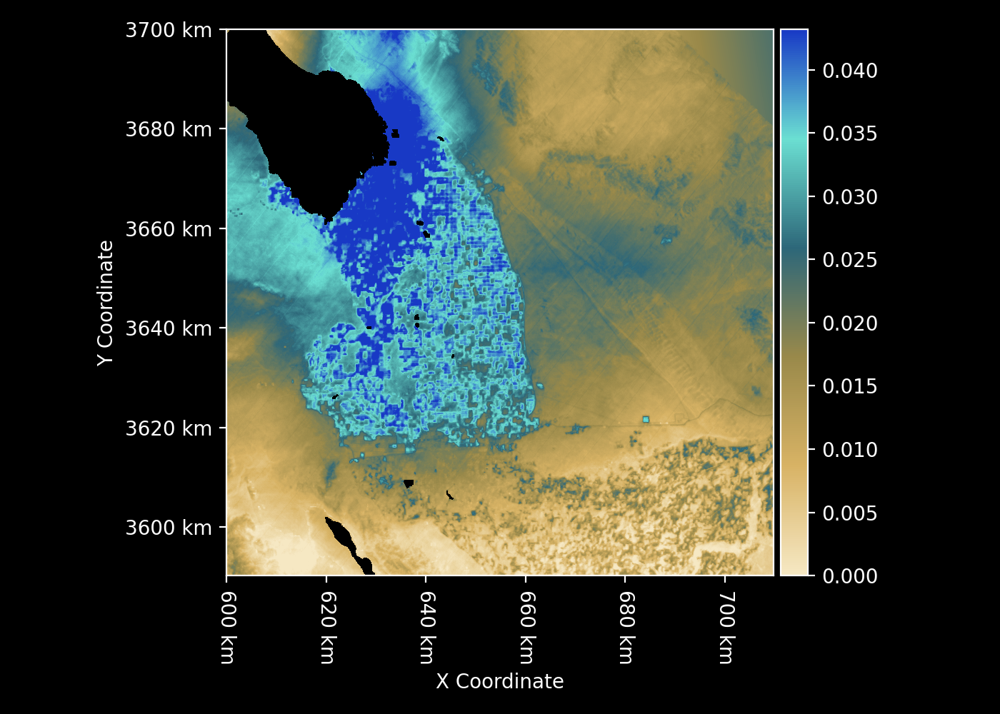

In [95]:
SM_filename = "ECOSTRESS_example_rasters/ECOv002_L3T_SM_21485_013_11SPS_20220420T211350_0700_01_SM.tif"

SM_cmap = LinearSegmentedColormap.from_list("SM", [
    "#f6e8c3",
    "#d8b365",
    "#99894a",
    "#2d6779",
    "#6bdfd2",
    "#1839c5"
])

SM_prior = rt.Raster.open(SM_filename, cmap=SM_cmap)

SM_prior

Loading air temperature prior from ECOSTRESS in Celsius, `Ta_C`

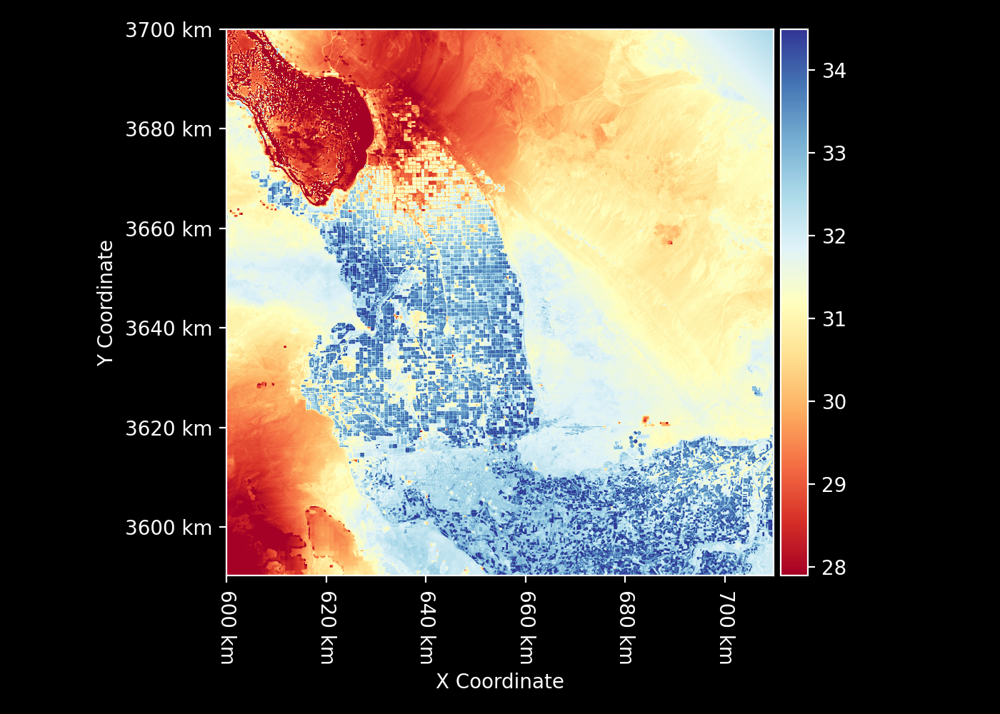

In [84]:
Ta_filename = "ECOSTRESS_example_rasters/ECOv002_L3T_MET_21485_013_11SPS_20220420T211350_0700_01_Ta.tif"
Ta_cmap = "RdYlBu"
Ta_C_prior = rt.Raster.open(Ta_filename, cmap=Ta_cmap)
Ta_C_prior

Loading relative humidity prior from ECOSTRESS as a ratio from 0 to 1, `RH`

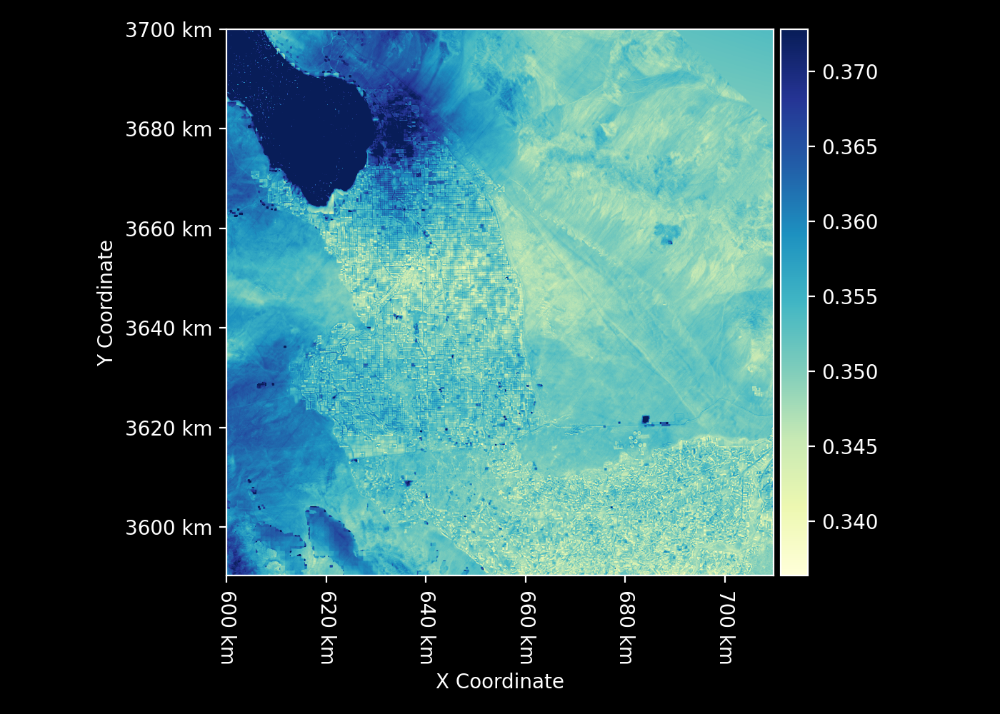

In [31]:
RH_filename = "ECOSTRESS_example_rasters/ECOv002_L3T_MET_21485_013_11SPS_20220420T211350_0700_01_RH.tif"
RH = rt.Raster.open(RH_filename, cmap="YlGnBu")
RH

Load normalized difference vegetation index (NDVI) from ECOSTRESS, a measure of the abundance of vegetation as a ratio from -1 to 1, `NDVI`

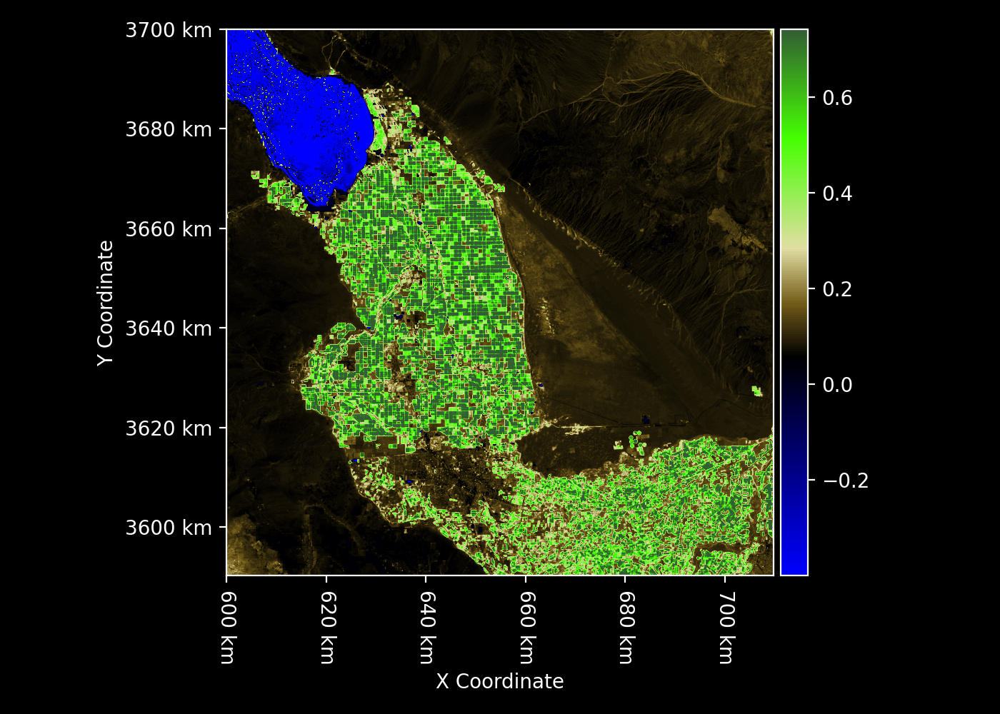

In [30]:
NDVI_filename = "ECOSTRESS_example_rasters/ECOv002_L2T_STARS_21485_013_11SPS_20220420_0700_01_NDVI.tif"

NDVI_cmap = LinearSegmentedColormap.from_list(
    name="NDVI",
    colors=[
        (0, "#0000ff"),
        (0.4, "#000000"),
        (0.5, "#745d1a"),
        (0.6, "#e1dea2"),
        (0.8, "#45ff01"),
        (1, "#325e32")
    ]
)

NDVI = rt.Raster.open(NDVI_filename, cmap=NDVI_cmap)

NDVI

Load albedo from ECOSTRESS, a measure of the proportion of sunlight that is reflected away from the surface as a ratio from 0 to 1, `albedo`

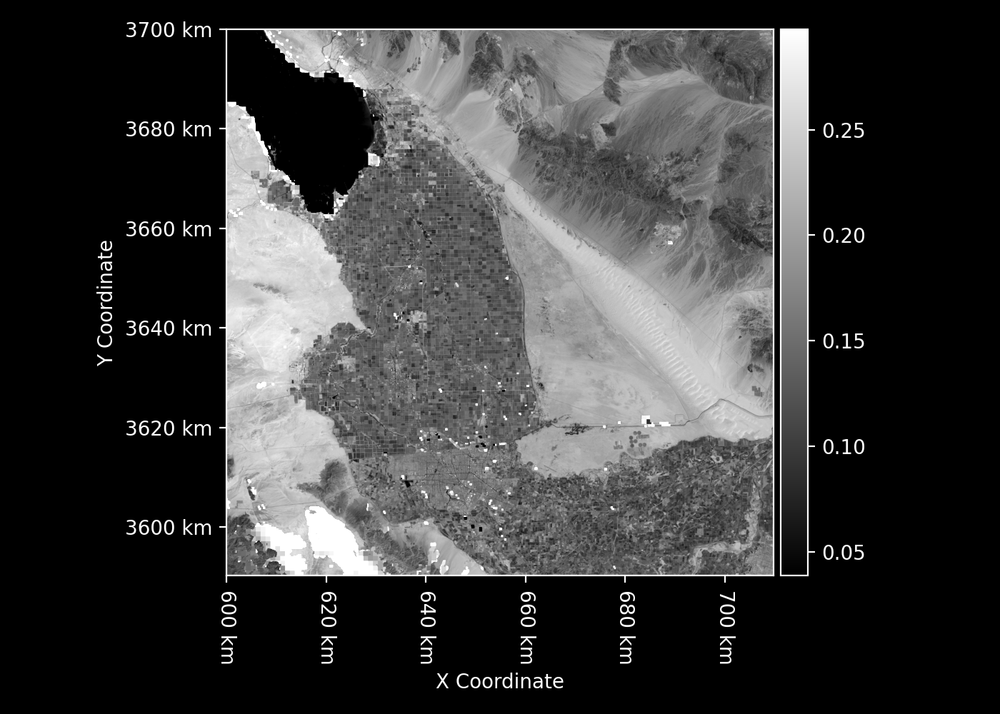

In [33]:
albedo_filename = "ECOSTRESS_example_rasters/ECOv002_L2T_STARS_21485_013_11SPS_20220420_0700_01_albedo.tif"
albedo_cmap = LinearSegmentedColormap.from_list(name="albedo", colors=["black", "white"])
albedo = rt.Raster.open(albedo_filename, cmap=albedo_cmap)
albedo

Calculate saturation vapor pressure (SVP) in hectopascal (hPa), `SVP_hPa`, an estimate of how much water the air can hold at its current temperature

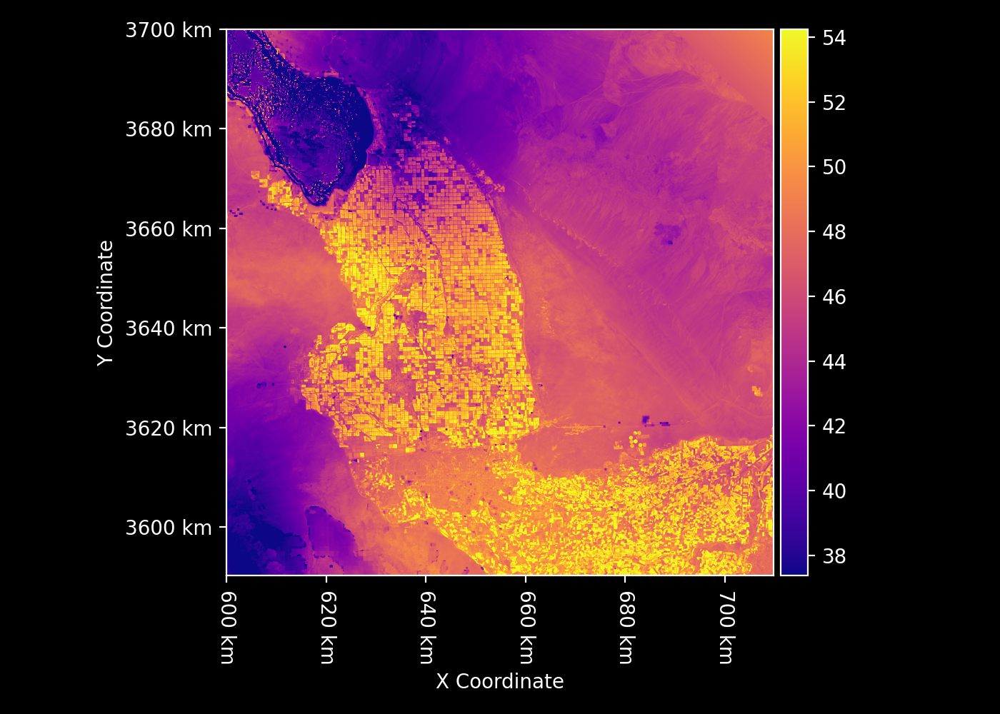

In [96]:
SVP_hPa = 6.13753 * (np.exp((17.27 * Ta_C_prior) / (Ta_C_prior + 237.3)))
SVP_hPa.cmap = "plasma"
SVP_hPa

Calculate humidity in the form of actual water vapor pressure in hectopascal, `Ea_hPa`

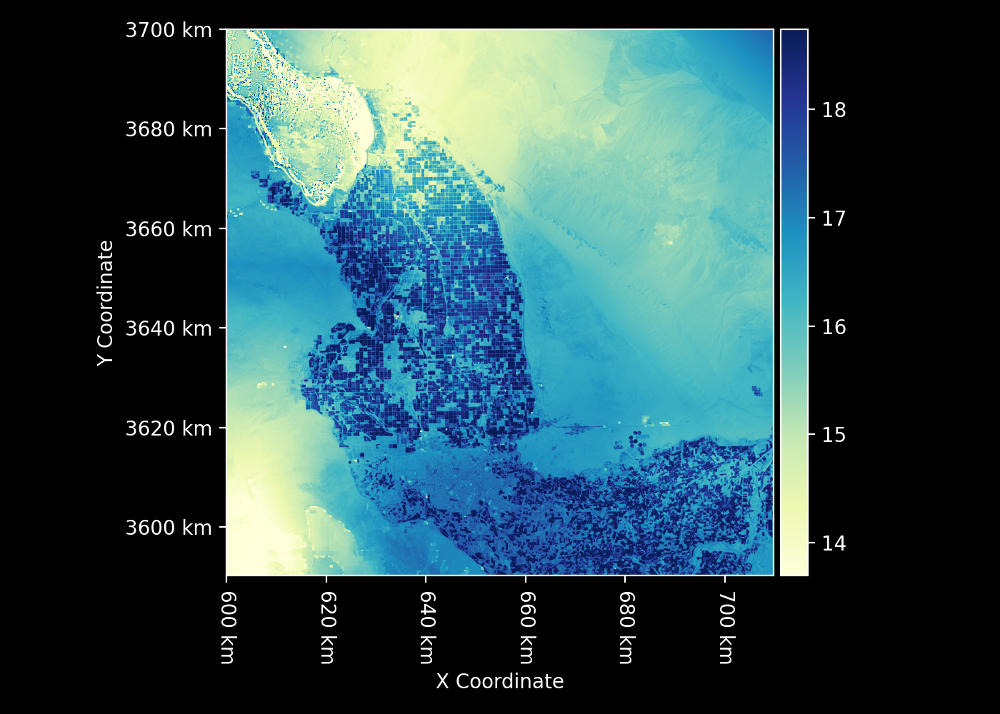

In [21]:
Ea_hPa = SVP_hPa * (RH)
Ea_hPa.cmap = "YlGnBu"
Ea_hPa

Calculate humidity in the form of dew-point temperature in Celsius, `Td_C`, the temperature at which air becomes saturated with moisture and water condenses

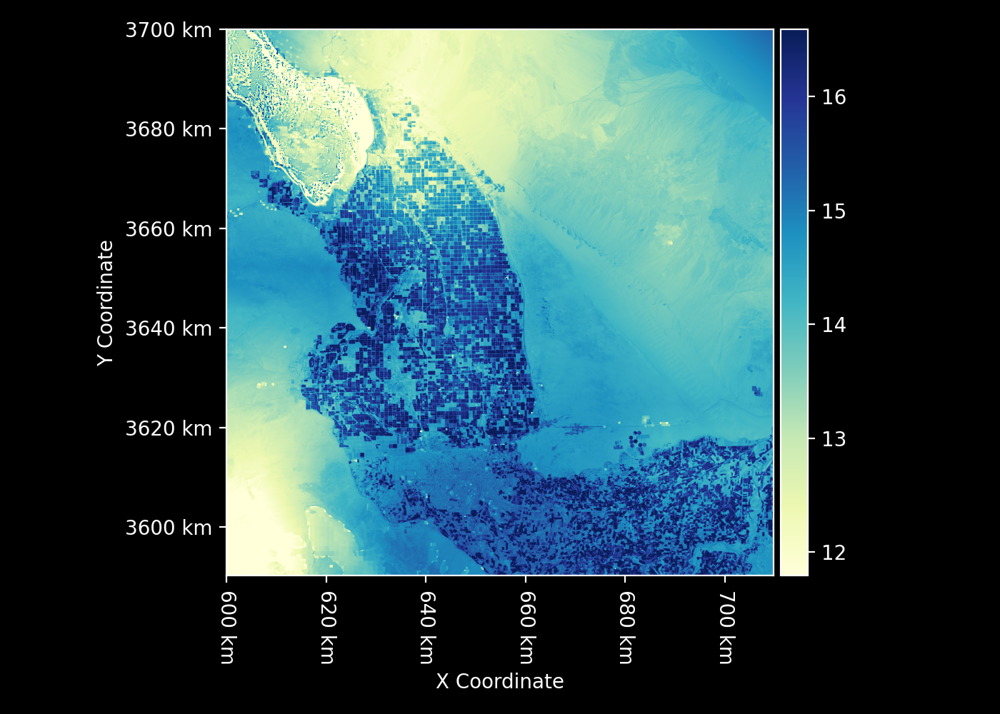

In [62]:
Td_C = 243.5 * np.log(Ea_hPa / 6.112) / (17.67 - np.log(Ea_hPa / 6.112))
Td_C.cmap = "YlGnBu"
Td_C

Calculation the SVP in hectopascal at skin-surface temperature in Celsius, `Estar_hPa`

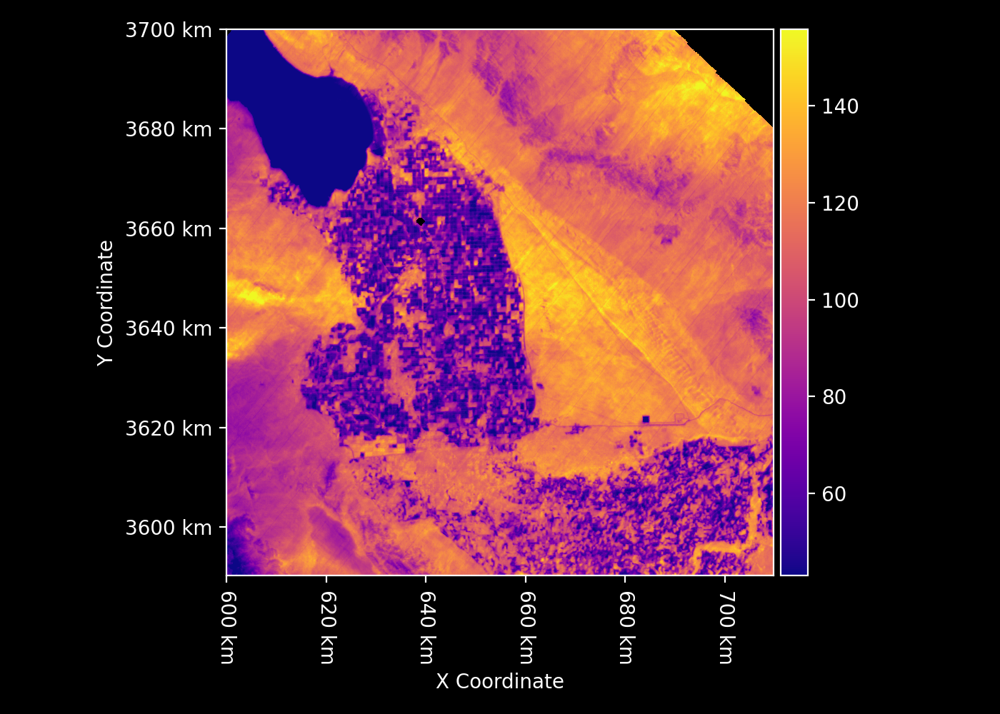

In [25]:
Estar_hPa = 6.13753 * np.exp((17.27 * ST_C) / (ST_C + 237.3))
Estar_hPa.cmap = "plasma"
Estar_hPa

Calculate soil heat flux (G) using the Surface Energy Balance Algorithm for Land (SEBAL) method, an estimate of how much available energy goes into the soil, `G_Wm2`.

1. **Soares, N. R., Costa, J. C. R. T. A., & Meirelles, R. L. J. J.** (2009). A comparison of soil heat flux parameterizations for use in land surface models. *Journal of Hydrometeorology, 10*(3), 856-869. [https://doi.org/10.1175/2008JHM978.1](https://doi.org/10.1175/2008JHM978.1)

2. **Nogueira, T. H. S., Silva, A. A. A., & Oliveira, M. S. S.** (2013). Evaluation of surface energy fluxes and soil heat flux in a semi-arid environment using ground and remote sensing measurements. *Agricultural and Forest Meteorology, 168*, 150-162. [https://doi.org/10.1016/j.agrformet.2012.09.008](https://doi.org/10.1016/j.agrformet.2012.09.008)

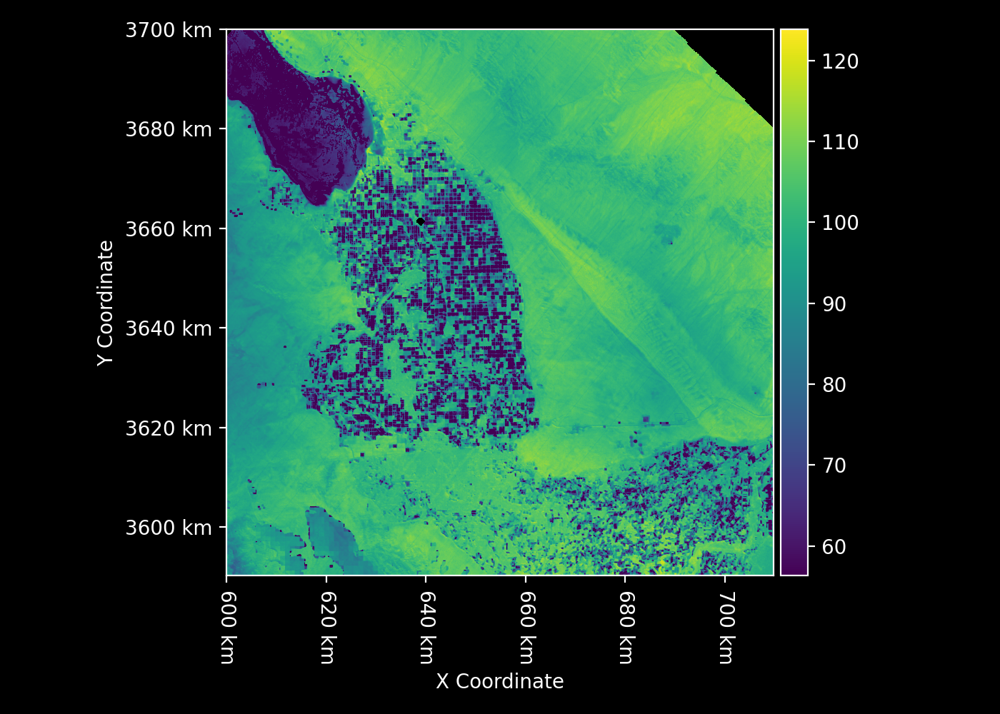

In [36]:
G_Wm2 = rt.clip(Rn_Wm2 * ST_C * (0.0038 + 0.0074 * albedo) * (1 - 0.98 * NDVI ** 4), 0, None)
G_Wm2.cmap = "viridis"
G_Wm2

Calculate the available energy at the surface for both air and plants in watts per square meter, `phi_Wm2`

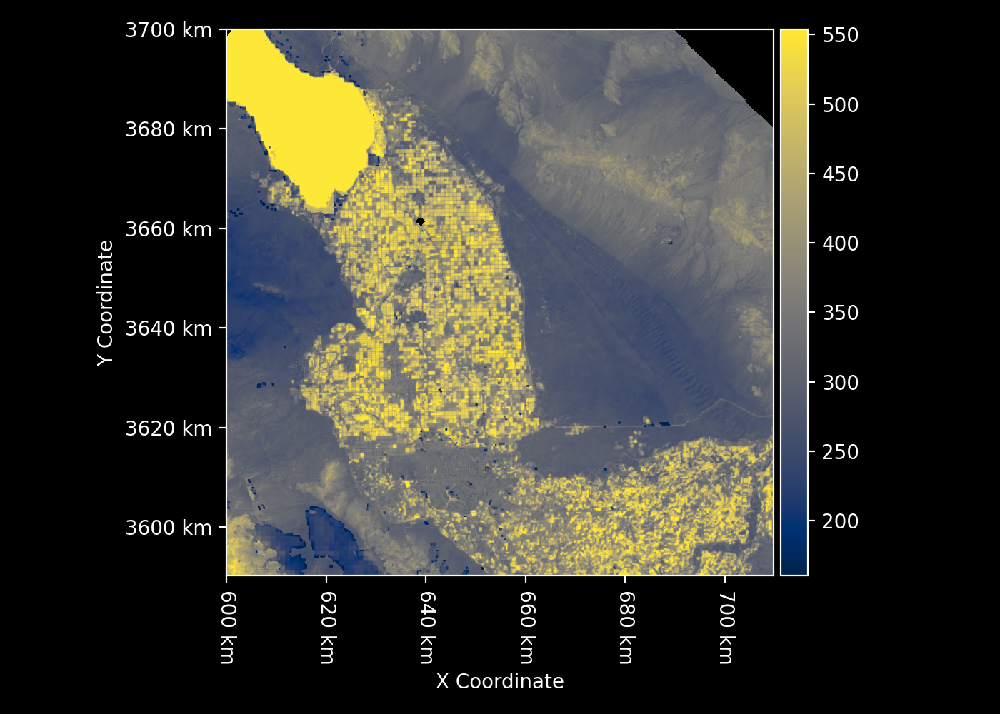

In [41]:
phi_Wm2 = Rn_Wm2 - G_Wm2
phi_Wm2.cmap = "cividis"
phi_Wm2

Calculate the difference between skin-surface temperature and near-surface air temperate as how much warmer in degrees Celsius the surface is than the air surrounding it, `dT_C`. This is an initial estimate using the air temperature prior.

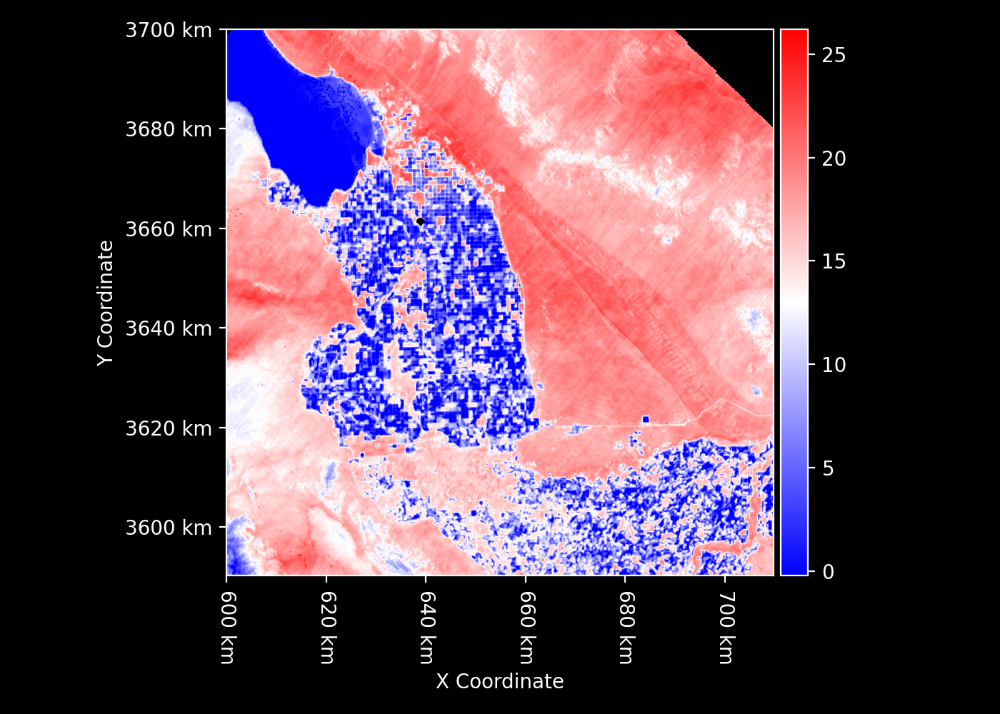

In [74]:
dT_C_prior = ST_C - Ta_C_prior
dT_cmap = LinearSegmentedColormap.from_list(name="albedo", colors=["blue", "white", "red"])
dT_C_prior.cmap = dT_cmap
dT_C_prior

Define the Priestley-Taylor `alpha` coefficient as `1.26`, representing the ratio of actual evapotranspiration to potential evapotranspiration under ideal conditions

In [42]:
alpha = 1.26

Define the psychrometric constant `gamma_hPa` in hectopascal per degree as `0.66`, in hectopascal per degree

In [52]:
gamma_hPa = 0.66

Calculate the slope of the saturation vapor pressure curve `delta_hPa` in hectopascal per degree

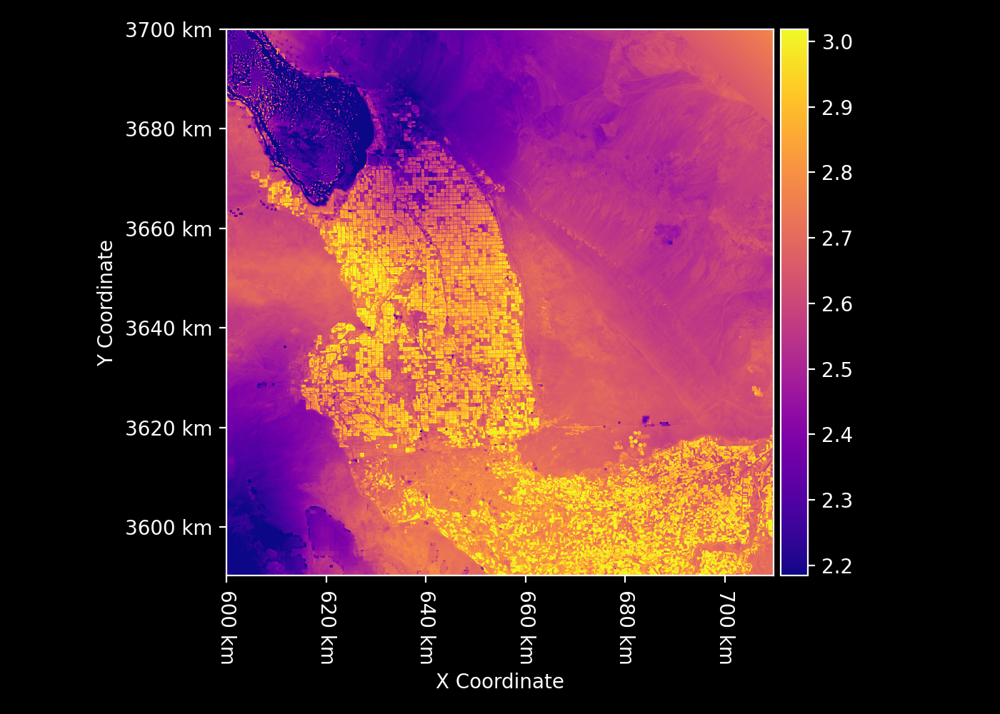

In [94]:
delta_hPa = 4098 * SVP_hPa / (Ta_C_prior + 237.3) ** 2
delta_hPa.cmap = "plasma"
delta_hPa

Calculate the proportion of net radiation that is used for evapotranspiration, `epsilon`, using the Priestley-Taylor method

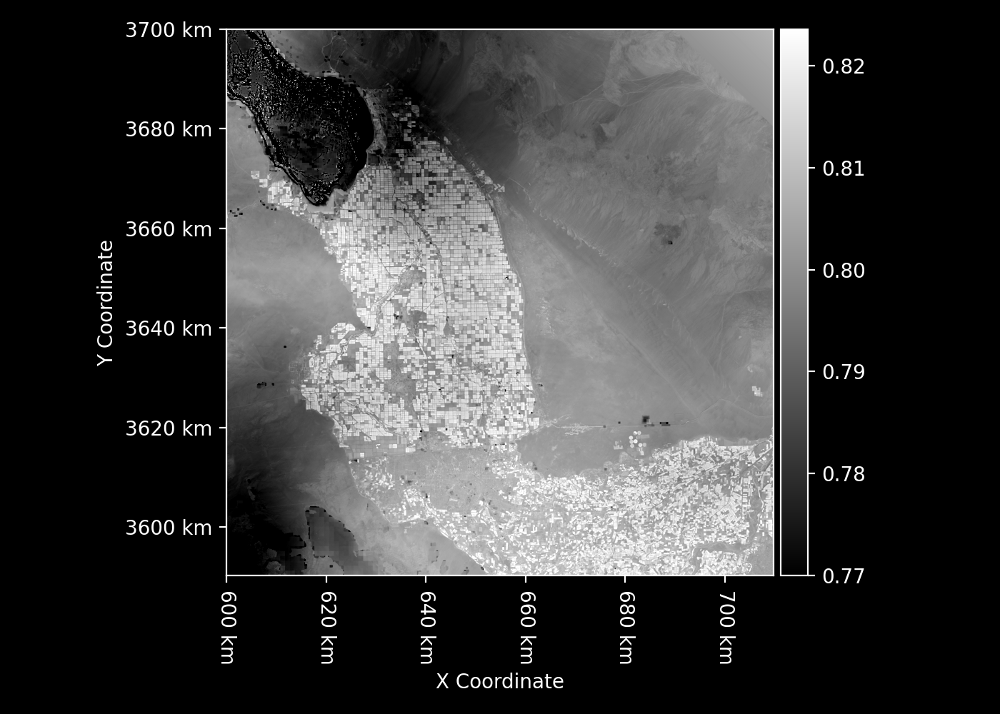

In [54]:
epsilon = delta_hPa / (delta_hPa + gamma_hPa)
epsilon.cmap = LinearSegmentedColormap.from_list(name="albedo", colors=["black", "white"])
epsilon

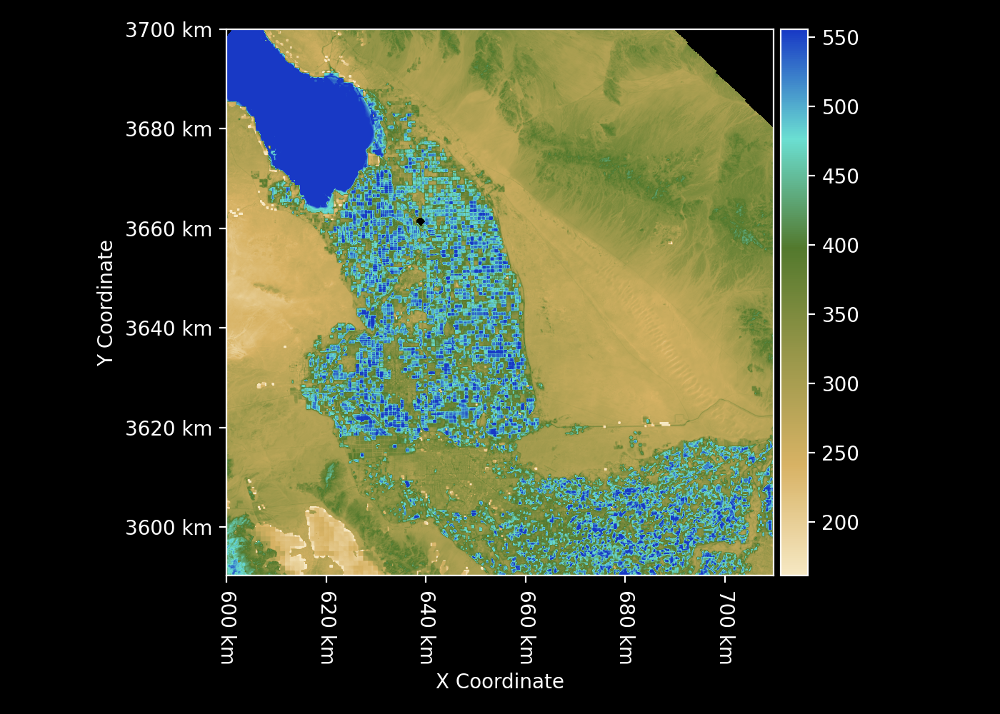

In [56]:
PET_Wm2 = alpha * epsilon * phi_Wm2

PET_Wm2.cmap = LinearSegmentedColormap.from_list("PET", [
    "#f6e8c3",
    "#d8b365",
    "#99974a",
    "#53792d",
    "#6bdfd2",
    "#1839c5"
])

PET_Wm2

Calculate the dew-point temperature in Celsius adjusted to the skin-surface temperature `Tsd_C`, according to the Surface Temperature Initiated Closure (STIC) method

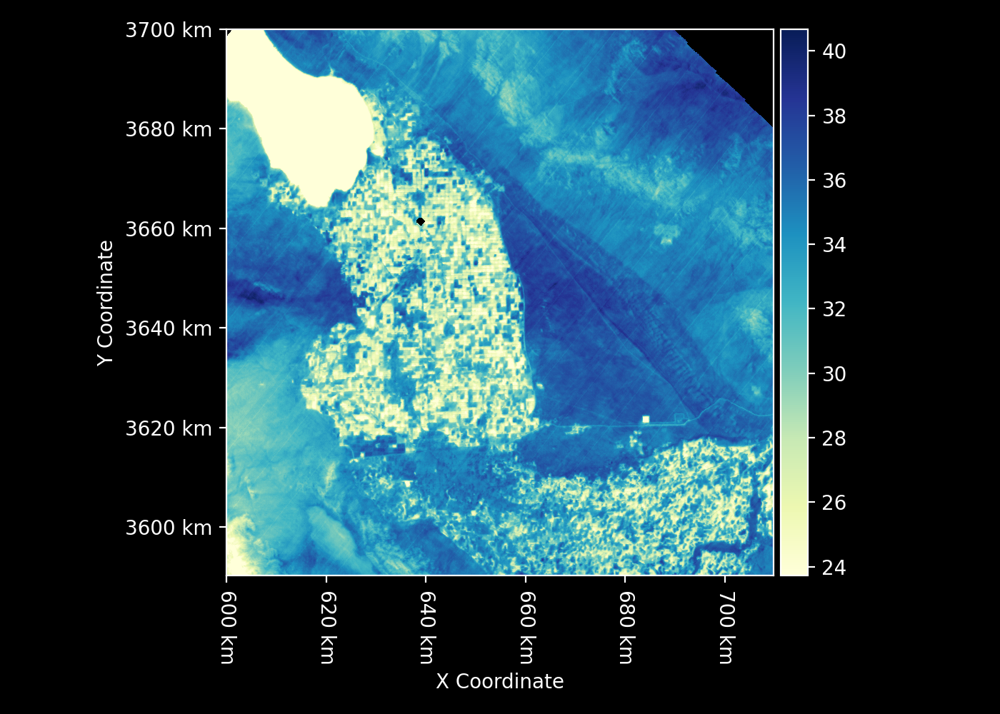

In [64]:
s33 = (45.03 + 3.014 * ST_C + 0.05345 * ST_C ** 2 + 0.00224 * ST_C ** 3) * 1e-2  # hpa/K
s1 = (45.03 + 3.014 * Td_C + 0.05345 * Td_C ** 2 + 0.00224 * Td_C ** 3) * 1e-2  # hpa/K
Tsd_C = ((Estar_hPa - Ea_hPa) - (s33 * ST_C) + (s1 * Td_C)) / (s1 - s33)
Tsd_C.cmap = "YlGnBu"
Tsd_C

Estimate root zone soil moisture in cubic meters per cubic meters `SMrz` using the STIC method

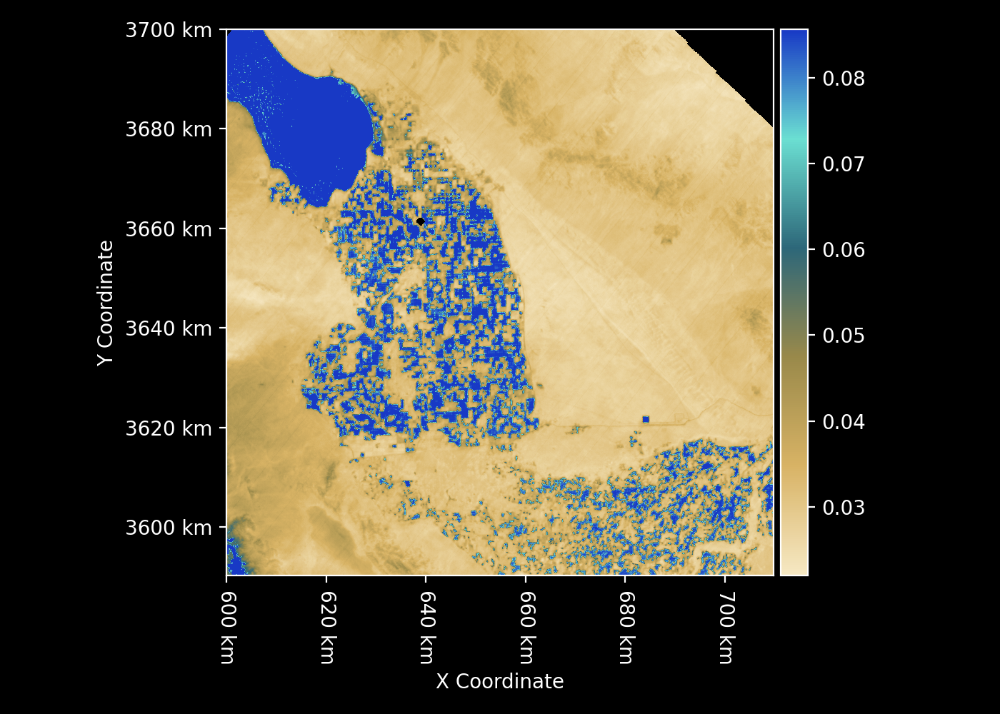

In [65]:
# slope of saturation vapor pressure and temperature
s3 = rt.where((dT_C_prior > -20) & (dT_C_prior < 5), (Estar_hPa - Ea_hPa) / (ST_C - Td_C),
    (45.03 + 3.014 * ST_C + 0.05345 * ST_C ** 2 + 0.00224 * ST_C ** 3) * 1e-2)  # hpa/K

# Surface Moisture (Ms)
# Surface wetness
Ms = (s1 / s3) * ((Tsd_C - Td_C) / (ST_C - Td_C))
Ms = rt.clip(rt.where((dT_C_prior < 0) & (Ms < 0) & (phi_Wm2 < 0), np.abs(Ms), Ms), 0, 1)

# Rootzone Moisture (Mrz)
s44 = (SVP_hPa - Ea_hPa) / (Ta_C_prior - Td_C)
SMrz = (gamma_hPa * s1 * (Tsd_C - Td_C)) / (
    delta_hPa * s3 * (ST_C - Td_C) + gamma_hPa * s44 * (Ta_C_prior - Td_C) - delta_hPa * s1 * (
    Tsd_C - Td_C))  # rootzone wetness
SMrz = rt.clip(rt.where((dT_C_prior < 0) & (SMrz < 0) & (phi_Wm2 < 0), np.abs(SMrz), SMrz), 0, 1)

SMrz.cmap = SM_cmap

SMrz

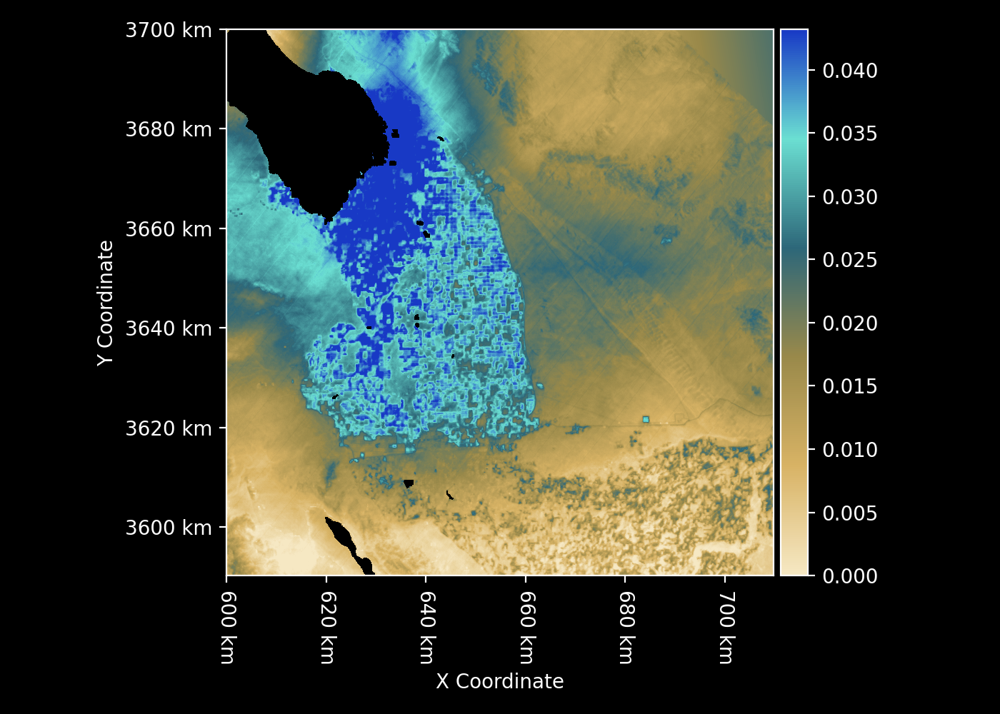

In [99]:
# soil moisture
SM_posterior = rt.where((PET_Wm2 > phi_Wm2) & (dT_C_prior > 0) & (Td_C <= 0), SMrz, SM_prior)
SM_posterior.cmap = SM_cmap
SM_posterior

Calculate the effective vapor pressure of the evaporating front near the surface in hectopascal `Es_hPa` 

Lee & Pielke, 1992

Segal, Jia, Ye & Pielke, 1990

Mallick et al, 2014

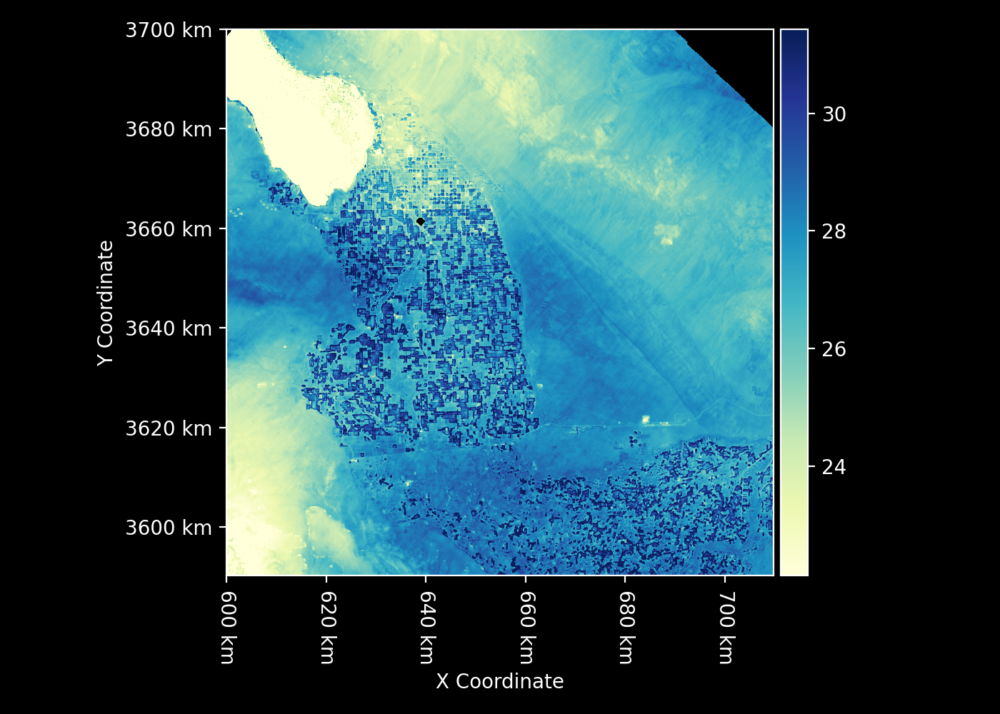

In [93]:
Es_hPa = rt.where((PET_Wm2 > phi_Wm2) & (dT_C_prior > 0) & (Td_C <= 0), Ea_hPa + SMrz * (Estar_hPa - Ea_hPa), Ea_hPa + Ms * (Estar_hPa - Ea_hPa))
Es_hPa.cmap = "YlGnBu"
Es_hPa

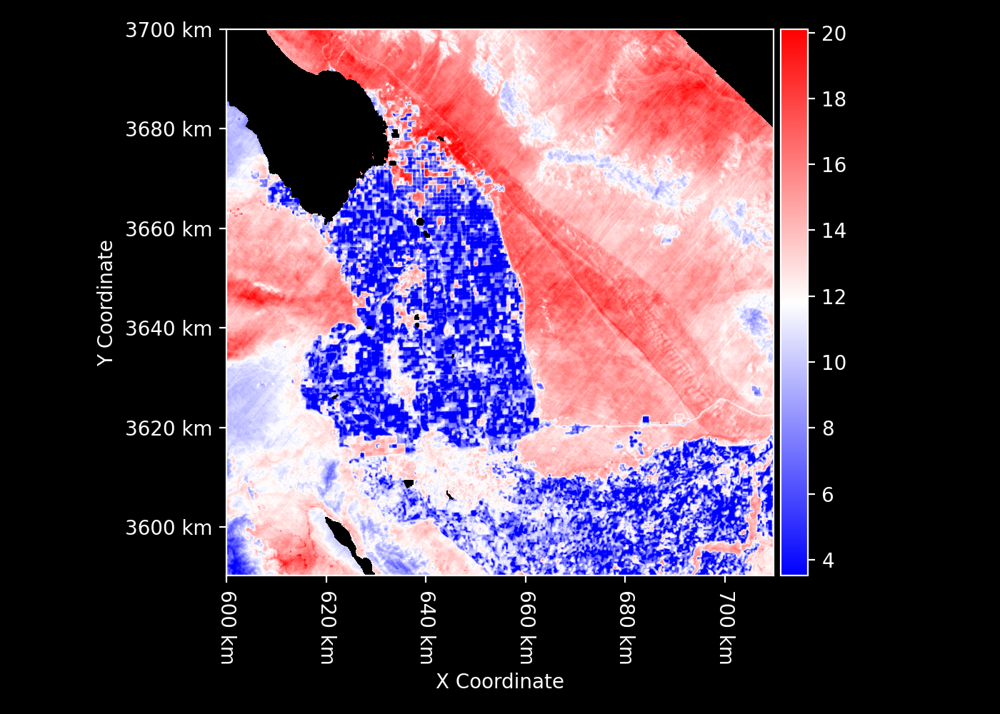

In [100]:
dT_C_posterior = (2 * delta_hPa * Es_hPa - 2 * delta_hPa * Ea_hPa - 2 * Ea_hPa * gamma_hPa + Es_hPa * gamma_hPa + Estar_hPa * gamma_hPa - SM_posterior * Es_hPa * gamma_hPa + SM_posterior * Estar_hPa * gamma_hPa + 2 * alpha * delta_hPa * Ea_hPa - 2 * alpha * delta_hPa * Es_hPa) / (2 * alpha * delta_hPa * gamma_hPa)
dT_C_posterior = rt.clip(dT_C_posterior, -10, 50)
dT_C_posterior.cmap = dT_cmap
dT_C_posterior

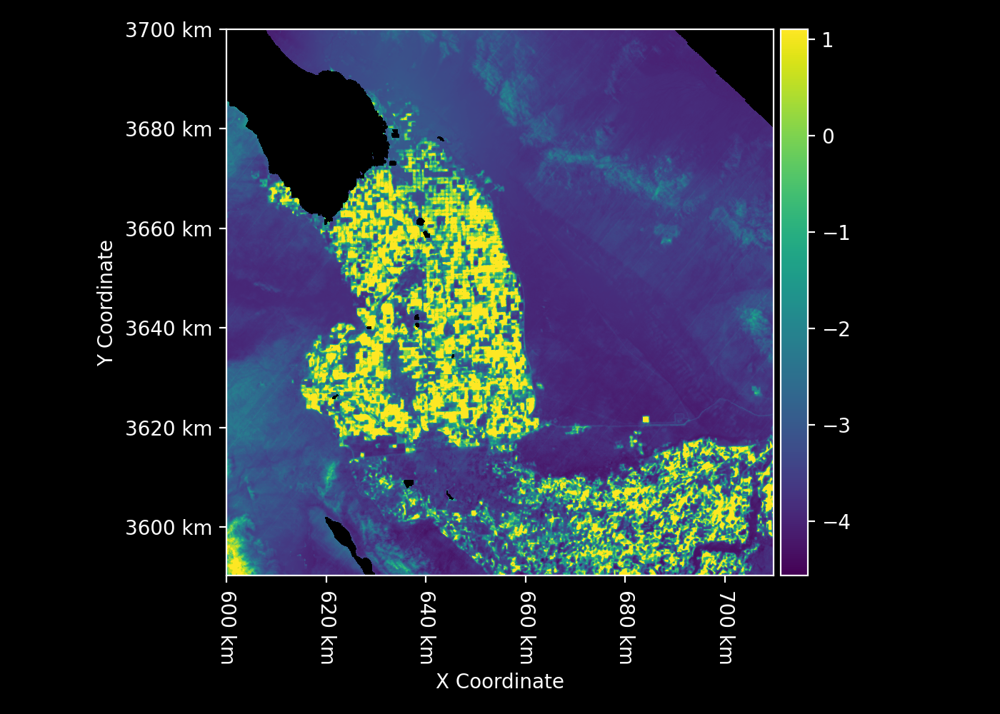

In [101]:
dT_C_change = dT_C_posterior - dT_C_prior
dT_C_change.cmap = "viridis"
dT_C_change

The STIC method calculates a posterior surface temperature from the posterior temperature difference, which is not ideal for transforming ECOSTRESS and SBG surface temperature observations into latent heat flux.

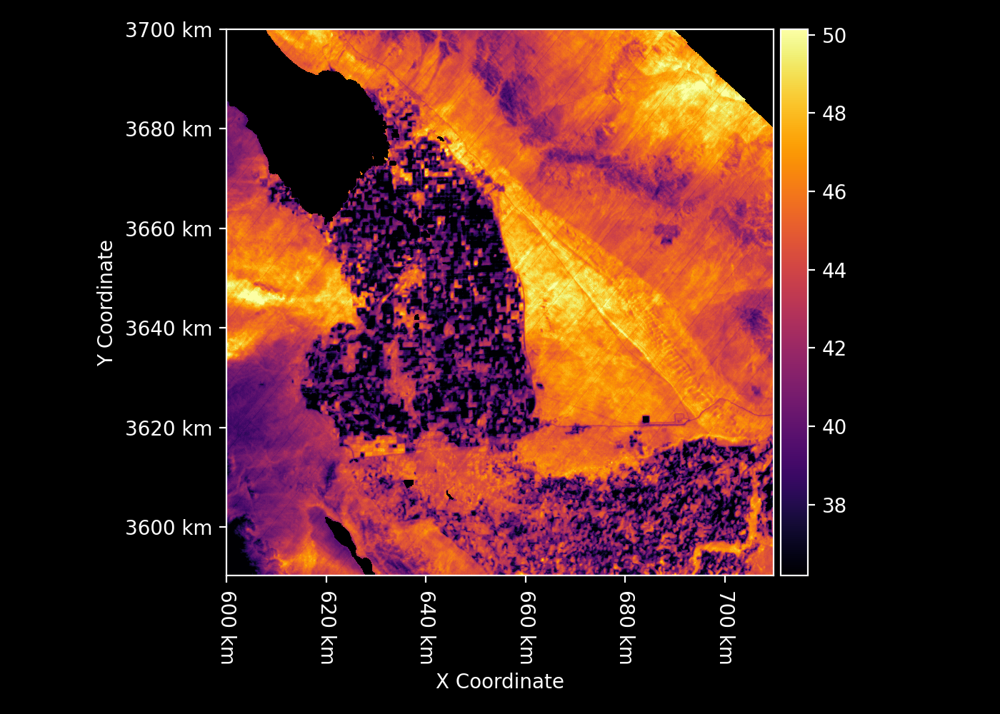

In [102]:
ST_C_posterior = dT_C_posterior + Ta_C_prior
ST_C_posterior.cmap = ST_cmap
ST_C_posterior

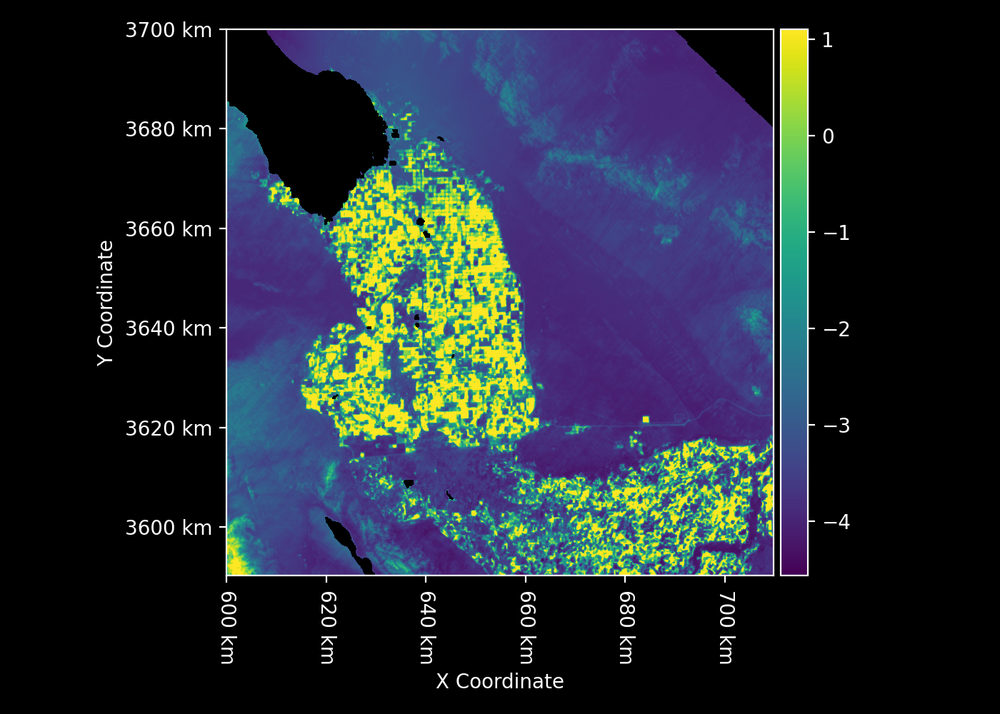

In [103]:
ST_C_change = ST_C_posterior - ST_C
ST_C_change.cmap = "viridis"
ST_C_change

The proposed air temperature correction method for ECOSTRESS and SBG based on STIC is to instead keep the surface temperature observation as a truth value and calculate a posterior air temperature

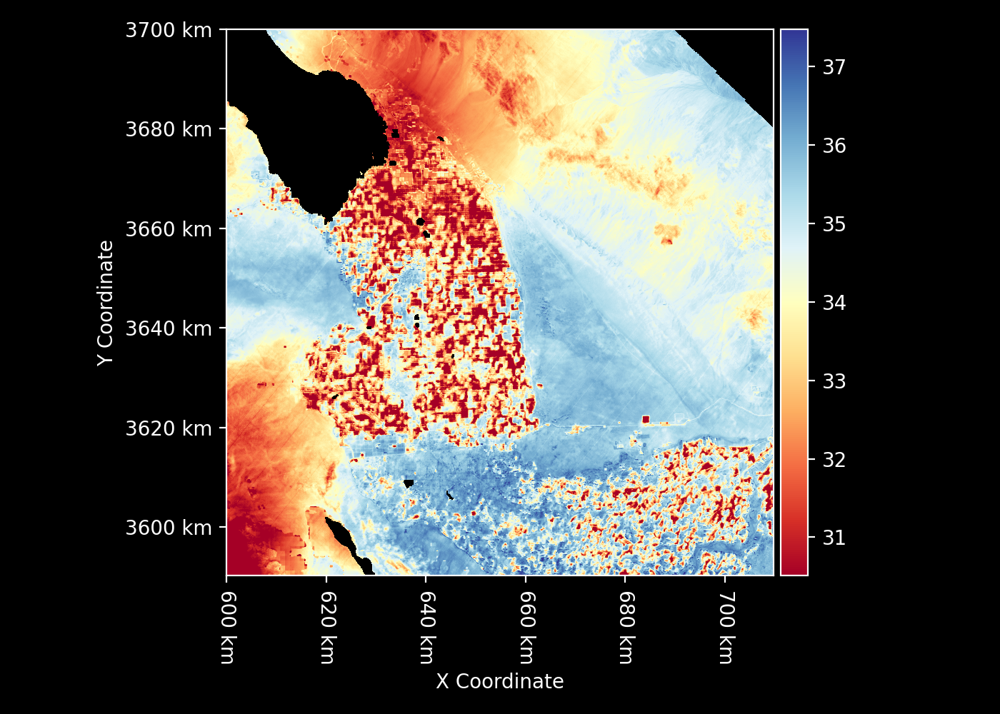

In [86]:
Ta_C_posterior = ST_C - dT_C_posterior
Ta_C_posterior.cmap = Ta_cmap
Ta_C_posterior

maximum change in air temperature: 8.2432861328125 °C


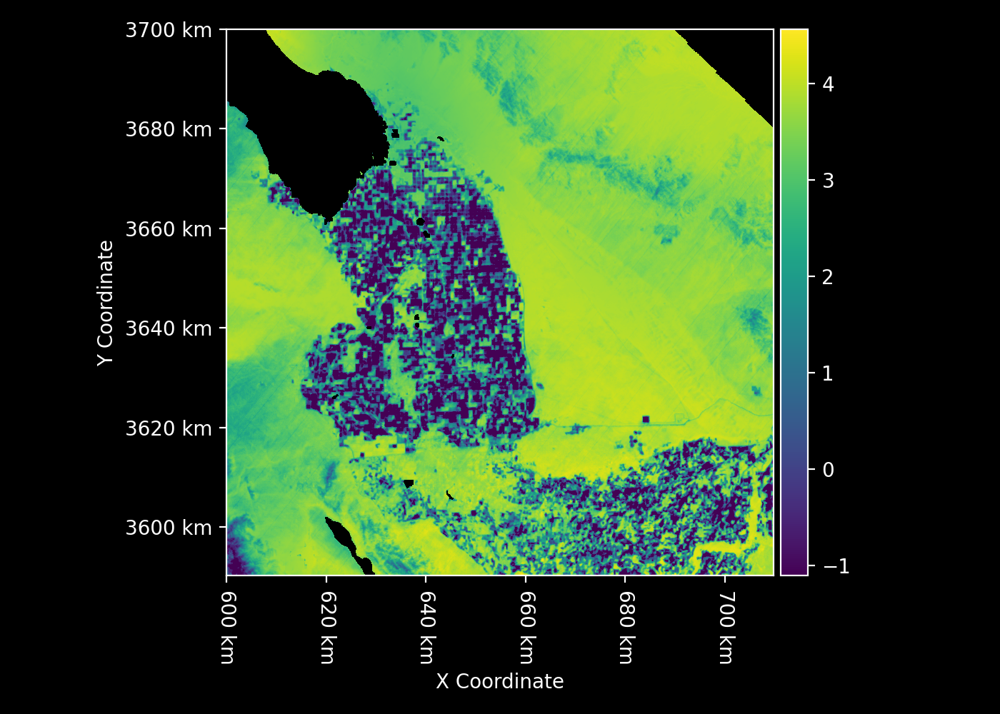

In [92]:
Ta_C_change = Ta_C_posterior - Ta_C_prior
Ta_C_change.cmap = "viridis"
print(f"maximum change in air temperature: {np.nanmax(np.abs(Ta_C_change))} °C")
Ta_C_change